<a href="https://colab.research.google.com/github/LHMade/LH-Made-Cookies/blob/main/sori_LH_Made_Cookies.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [17]:
# 한글 폰트
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
fonts-nanum is already the newest version (20200506-1).
0 upgraded, 0 newly installed, 0 to remove and 18 not upgraded.
/usr/share/fonts: caching, new cache contents: 0 fonts, 1 dirs
/usr/share/fonts/truetype: caching, new cache contents: 0 fonts, 3 dirs
/usr/share/fonts/truetype/humor-sans: caching, new cache contents: 1 fonts, 0 dirs
/usr/share/fonts/truetype/liberation: caching, new cache contents: 16 fonts, 0 dirs
/usr/share/fonts/truetype/nanum: caching, new cache contents: 12 fonts, 0 dirs
/usr/local/share/fonts: caching, new cache contents: 0 fonts, 0 dirs
/root/.local/share/fonts: skipping, no such directory
/root/.fonts: skipping, no such directory
/usr/share/fonts/truetype: skipping, looped directory detected
/usr/share/fonts/truetype/humor-sans: skipping, looped directory detected
/usr/share/fonts/truetype/liberation: skipping, looped directory detected
/usr/share/fonts/truetype/

In [2]:
# 지도
!pip install folium

In [5]:
from google.colab import files
uploaded = files.upload()

Saving 7.성남시_지식산업센터.csv to 7.성남시_지식산업센터.csv


In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.rc('font', family='NanumBarunGothic')

import folium
from folium.plugins import MarkerCluster
import matplotlib.cm as cm
import matplotlib.colors as mcolors

import geopandas as gpd

# **1. 성남시 지식산업센터**

In [2]:
# 파일 경로
file_path = "/content/7.성남시_지식산업센터.csv"
# 데이터 로드
df = pd.read_csv(file_path, encoding='utf-8')

In [3]:
# 최신 입주 기업 수 (2024년 6월 데이터 사용)
latest_col = 'cpn_in_2406'
df['vacancy_rate'] = 1 - (df[latest_col] / df['tot_cpn'])

In [4]:
# 공실률 값 조정 (0~1 범위 내에서 clipping)
df['vacancy_rate'] = df['vacancy_rate'].clip(0, 1)

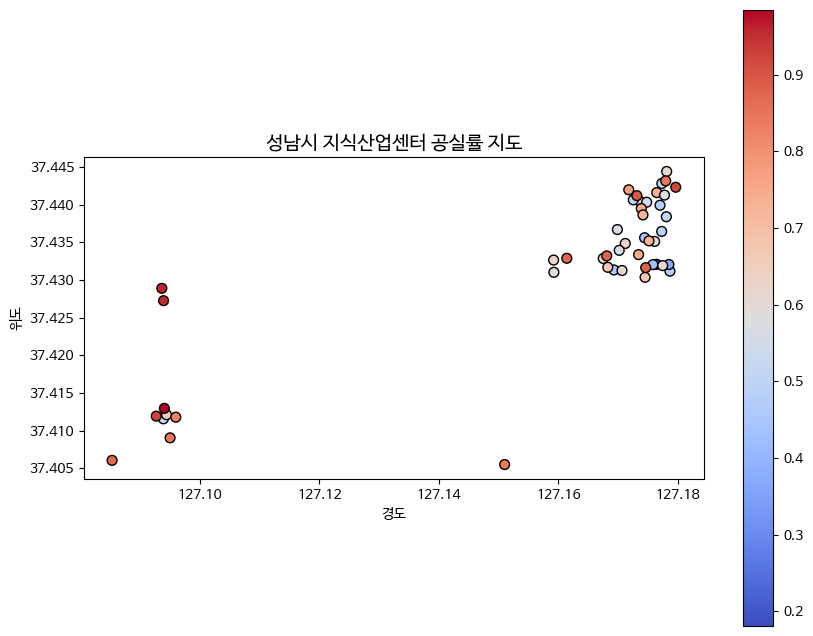

In [5]:
# GeoDataFrame 변환 (공간 데이터 활용)
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['lon'], df['lat']), crs="EPSG:4326")

# 지도 시각화 (공실률을 색상으로 표시)
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot(column='vacancy_rate', cmap='coolwarm', legend=True, markersize=50, ax=ax, edgecolor='black')

# 제목 및 라벨 설정
ax.set_title("성남시 지식산업센터 공실률 지도", fontsize=14)
ax.set_xlabel("경도")
ax.set_ylabel("위도")

# 지도 표시
plt.show()

In [7]:
# 지도 중심 좌표 설정 (성남시 중심점)
center_lat = gdf['lat'].mean()
center_lon = gdf['lon'].mean()

# Folium 지도 생성
m = folium.Map(location=[center_lat, center_lon], zoom_start=12, tiles="cartodbpositron")

# MarkerCluster 추가 (공실률을 반영한 버블 크기)
marker_cluster = MarkerCluster().add_to(m)

# 각 지식산업센터에 대한 마커 추가
for _, row in gdf.iterrows():
    vacancy_rate = row['vacancy_rate']
    radius = vacancy_rate * 20  # 공실률을 반영한 원 크기 조정

    folium.CircleMarker(
        location=[row['lat'], row['lon']],
        radius=radius,
        color="red" if vacancy_rate > 0.5 else "blue",
        fill=True,
        fill_color="red" if vacancy_rate > 0.5 else "blue",
        fill_opacity=0.6,
        popup=f"{row['klg_ids_ct_nm']}<br>공실률: {vacancy_rate:.2%}",
    ).add_to(marker_cluster)

# 지도 표시
m

# **2. 성남시 거주인구**


In [ ]:
# 데이터 불러오기
file_path = '/content/1.성남시_거주인구.csv'
population_data = pd.read_csv(file_path)

In [ ]:
# 데이터 확인
print("데이터 구조 확인:")
print(population_data.head())
print("\n결측값 확인:")
print(population_data.isnull().sum())

데이터 구조 확인:
        gid  year  m_20g_pop  w_20g_pop  m_30g_pop  w_30g_pop  m_40g_pop  \
0  다사730391  2023        NaN        NaN        NaN        NaN        NaN   
1  다사676304  2023       25.0       14.0       18.0       22.0       23.0   
2  다사676300  2023        0.0        0.0        0.0        0.0        0.0   
3  다사676301  2023        0.0        0.0        0.0        0.0        0.0   
4  다사632298  2023        NaN        NaN        NaN        NaN        NaN   

   w_40g_pop  m_50g_pop  w_50g_pop  m_60g_pop  w_60g_pop  m_70g_pop  \
0        NaN        NaN        NaN        NaN        NaN        NaN   
1       24.0       23.0       27.0       18.0       14.0        0.0   
2        0.0        0.0        0.0        0.0        0.0        0.0   
3        0.0        7.0        8.0        7.0        0.0        NaN   
4        NaN        NaN        NaN        NaN        NaN        NaN   

   w_70g_pop  m_80g_pop  w_80g_pop  m_90g_pop  w_90g_pop  m_100g_pop  \
0        NaN        NaN        Na

In [ ]:
# 결측값 처리: NaN 값을 0으로 대체
population_data.fillna(0, inplace=True)

In [ ]:
# 연령대별 남녀 인구 합계 계산
population_data['total_20s'] = population_data['m_20g_pop'] + population_data['w_20g_pop']
population_data['total_30s'] = population_data['m_30g_pop'] + population_data['w_30g_pop']
population_data['total_40s'] = population_data['m_40g_pop'] + population_data['w_40g_pop']
population_data['total_50s'] = population_data['m_50g_pop'] + population_data['w_50g_pop']
population_data['total_60s'] = population_data['m_60g_pop'] + population_data['w_60g_pop']
population_data['total_70s'] = population_data['m_70g_pop'] + population_data['w_70g_pop']
population_data['total_80s'] = population_data['m_80g_pop'] + population_data['w_80g_pop']
population_data['total_90s'] = population_data['m_90g_pop'] + population_data['w_90g_pop']
population_data['total_100s'] = population_data['m_100g_pop'] + population_data['w_100g_pop']

In [ ]:
# 연령대별 총합 계산
age_group_totals = population_data[
    [
        'total_20s', 'total_30s', 'total_40s', 'total_50s',
        'total_60s', 'total_70s', 'total_80s', 'total_90s', 'total_100s'
    ]
].sum()

In [ ]:
# 연령대별 총합 출력
print("\n연령대별 총 인구:")
print(age_group_totals)


연령대별 총 인구:
total_20s     450790.0
total_30s     510905.0
total_40s     573443.0
total_50s     607696.0
total_60s     488579.0
total_70s     224297.0
total_80s      89106.0
total_90s       3605.0
total_100s       298.0
dtype: float64


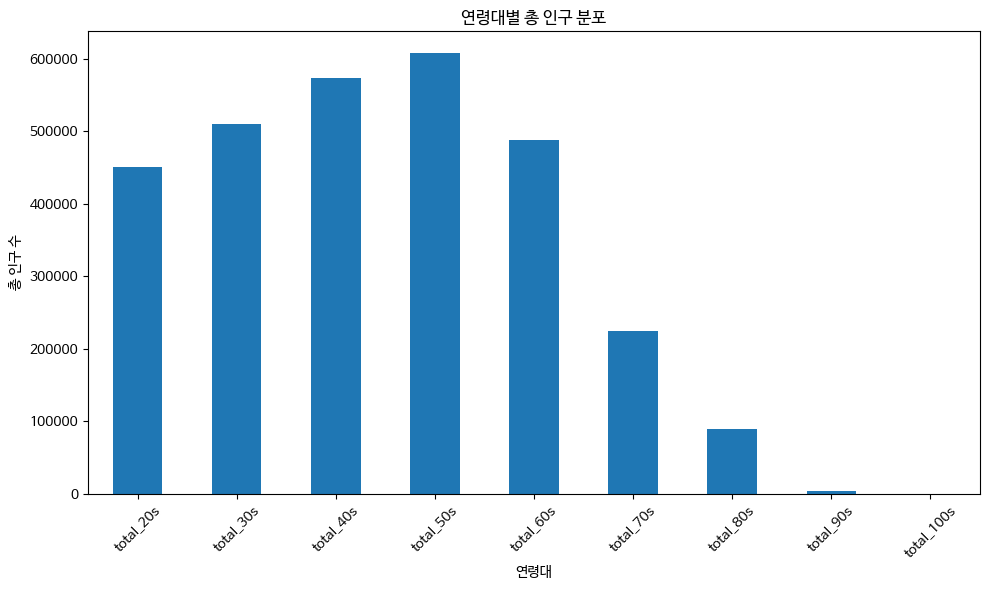

In [ ]:
# 시각화: 연령대별 인구 분포
age_group_totals.plot(kind='bar', figsize=(10, 6))
plt.title('연령대별 총 인구 분포')
plt.xlabel('연령대')
plt.ylabel('총 인구 수')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
# gid별 총 인구 계산
population_data['total_population'] = (
    population_data['total_20s'] + population_data['total_30s'] +
    population_data['total_40s'] + population_data['total_50s'] +
    population_data['total_60s'] + population_data['total_70s'] +
    population_data['total_80s'] + population_data['total_90s'] +
    population_data['total_100s']
)

In [ ]:
# gid별 총 인구 분포 상위 10개 출력
print("\n지역별 총 인구 (상위 10개):")
print(population_data[['gid', 'total_population']].sort_values(by='total_population', ascending=False).head(10))


지역별 총 인구 (상위 10개):
            gid  total_population
6799   다사640317            2918.0
51597  다사650280            2362.0
43538  다사650280            2299.0
28316  다사650280            2224.0
5829   다사650280            2216.0
6118   다사652303            2160.0
51075  다사652303            2160.0
41099  다사652303            2103.0
15234  다사652303            2089.0
57756  다사680373            2012.0


In [ ]:
# 데이터 년도별로 나누기
years = population_data['year'].unique()
yearly_data = {year: population_data[population_data['year'] == year] for year in years}


--- 2023년도 데이터 ---
gid
다사581304    0.0
다사581305    0.0
다사581306    0.0
다사582304    0.0
다사582305    0.0
다사582306    0.0
다사582307    0.0
다사582308    0.0
다사582309    0.0
다사582310    0.0
Name: total_population, dtype: float64


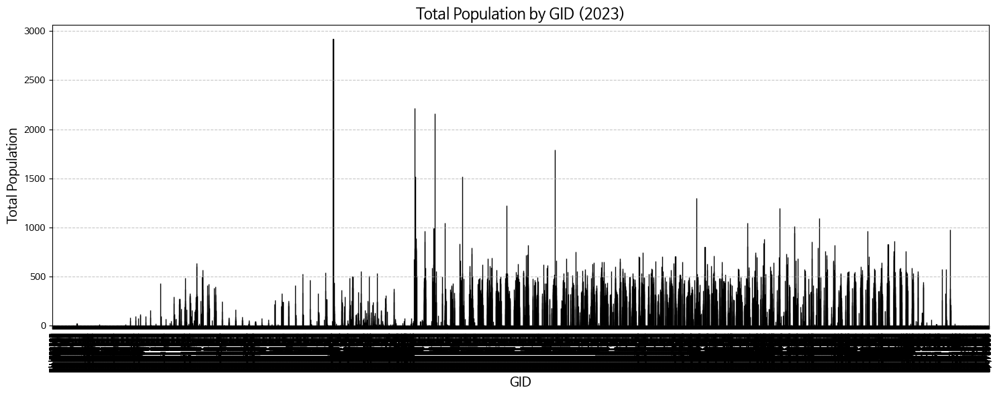


--- 2022년도 데이터 ---
gid
다사581304    0.0
다사581305    0.0
다사581306    0.0
다사582304    0.0
다사582305    0.0
다사582306    0.0
다사582307    0.0
다사582308    0.0
다사582309    0.0
다사582310    0.0
Name: total_population, dtype: float64


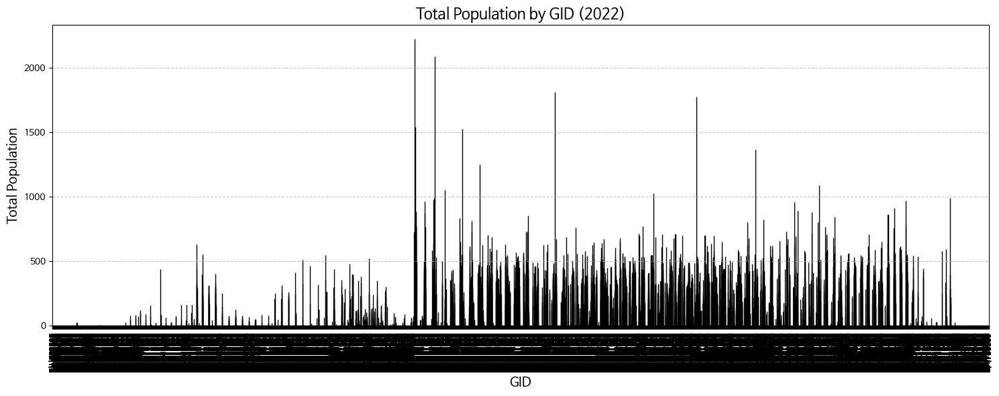


--- 2021년도 데이터 ---
gid
다사581304    0.0
다사581305    0.0
다사581306    0.0
다사582304    0.0
다사582305    0.0
다사582306    0.0
다사582307    0.0
다사582308    0.0
다사582309    0.0
다사582310    0.0
Name: total_population, dtype: float64


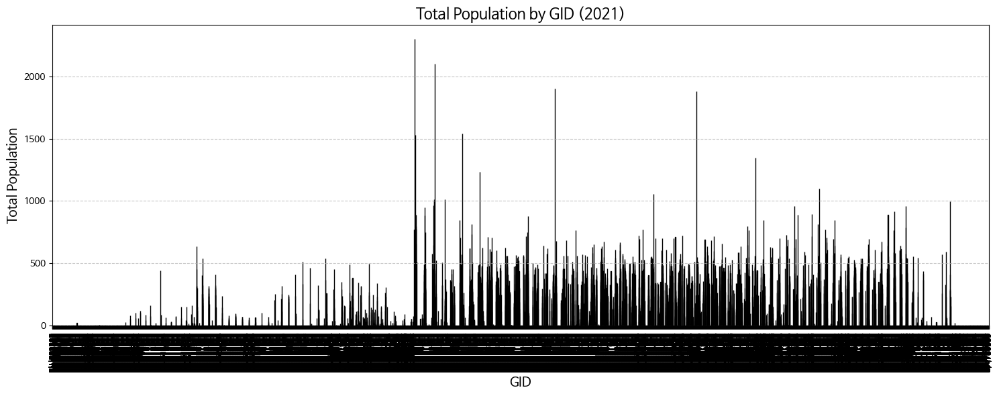


--- 2020년도 데이터 ---
gid
다사581304    0.0
다사581305    0.0
다사581306    0.0
다사582304    0.0
다사582305    0.0
다사582306    0.0
다사582307    0.0
다사582308    0.0
다사582309    0.0
다사582310    0.0
Name: total_population, dtype: float64


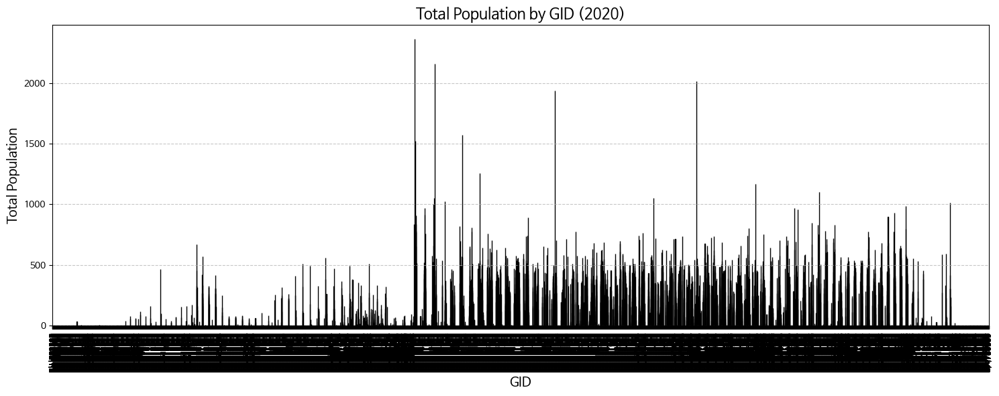

In [ ]:
# GID별 총 인구 계산 및 시각화
for year, data in yearly_data.items():
    print(f"\n--- {year}년도 데이터 ---")
    gid_population = data.groupby('gid')['total_population'].sum()
    print(gid_population.head(10))  # 상위 10개 GID 출력

    # 연도별 GID 총 인구 시각화
    plt.figure(figsize=(15, 6))
    gid_population.plot(kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Total Population by GID ({year})', fontsize=16)
    plt.xlabel('GID', fontsize=14)
    plt.ylabel('Total Population', fontsize=14)
    plt.xticks(rotation=90, fontsize=8)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

In [ ]:
# 지역 그룹핑 동적 색상 생성
unique_gids = population_data['gid'].unique()
norm = mcolors.Normalize(vmin=0, vmax=len(unique_gids))
color_map = cm.get_cmap('tab20', len(unique_gids))
gid_colors = {gid: mcolors.to_hex(color_map(norm(i))) for i, gid in enumerate(unique_gids)}

# 버블 크기 정규화
min_population = population_data['total_population'].min()
max_population = population_data['total_population'].max()

# Folium 지도에 버블 차트 추가 (년도별로)
maps = {}
years = population_data['year'].unique()

for year in years:
    # 연도별 데이터 필터링
    year_data = population_data[population_data['year'] == year]

    # 지도 생성
    map_center = [37.5, 127.2]
    m = folium.Map(location=map_center, zoom_start=12)

    # 지도에 버블 차트 추가
    for _, row in year_data.iterrows():
        color = gid_colors[row['gid']]  # GID별 색상 설정
        # 상대적인 크기 계산 (최소 크기 5 ~ 최대 크기 50)
        radius = 5 + ((row['total_population'] - min_population) / (max_population - min_population)) * 45

        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],  # 좌표
            radius=radius,  # 정규화된 원 크기
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.6,
            popup=folium.Popup(
                f"Year: {year}<br>GID: {row['gid']}<br>Total Population: {row['total_population']}",
                max_width=250
            )
        ).add_to(m)

    # 지도 저장
    maps[year] = m
    m.save(f"gid_population_map_{year}.html")
    print(f"지도 저장 완료: gid_population_map_{year}.html")

<ipython-input-35-216e474a387c>:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  color_map = cm.get_cmap('tab20', len(unique_gids))


지도 저장 완료: gid_population_map_2023.html
지도 저장 완료: gid_population_map_2022.html
지도 저장 완료: gid_population_map_2021.html
지도 저장 완료: gid_population_map_2020.html


In [ ]:
maps[2023]  # 2023년도 지도 표시